# Deep Dream
  - 딥드림이란?
  - 딥드립 구현

### 딥드림이란
- 사전에 학습된 합성곱 신경망(Convolutional Neural Network, CNN)의 은닉층을 활용하여 원본 이미지의 픽셀을 변형하는 기술이다. 이 기술은 이미지를 생성하거나 이미지의 시각적 특징을 강조하거나 왜곡하는 데 사용된다.
  - 전체적인 프로세스 과정
    1. 사전 학습된 CNN모델에 이미지 통과
    2. 모델의 특정 은닉층의 활성화 함수값을 얻는다.
    3. 해당 은닉층의 활성화 값을 최대화(경사 상승법)하기 위해 입력 이미지의 픽셀을 변경. 이는 해당 은닉층이 인식하는 패턴이 이미지에 더 강하게 표현되도록 만든다.
    4. 변경 된 이미지를 1,2,3번 과정 다시 반복
   
    \* 은닉층의 활성화 함수 값을 최대화 한다는것은 주로 이미지에서 발견된 시각적 특징이나 패턴을 강조하고 강화하는 것이다.
  


# Importing the libraries
- tensorflow 딥드림 가이드 문서: https://www.tensorflow.org/beta/tutorials/generative/deepdream

In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
tf.__version__

'2.15.0'

### Loading the pre-built convolutional neural network
- 합성곱 신경망의 합성곱 층과 폴링 층만 전이학습한다.
  - 분류를 할것이 아니고 이미지의 시각적 특징들을 사용하여 이미지를 변환하기 때문이다.

- 사전 학습 모델 정보
  - InceptionNet(tensorflow 제공): https://www.tensorflow.org/api_docs/python/tf/keras/applications/inception_v3
  - Original paper(InceptionNet 원본): https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Szegedy_Rethinking_the_Inception_CVPR_2016_paper.pdf
  - Imagenet: http://www.image-net.org/


In [ ]:
# 밀집 신경망을 제외한 신경망 레이어를 불러옴 (imagenet을 사용하여 학습한 inceptionv3 모델 전이학습)
base_model = tf.keras.applications.InceptionV3(include_top=False, weights='imagenet')

87910968/87910968 [==============================] - 2s 0us/step


In [ ]:
# mixde*(concatenate)층이 보이는데 이 층은 그전의 합성곱층들을 연결해주는 레이어라고 알고있어라. -> 딥드림에서 중요한 기술
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, None, None, 3)]      0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, None, None, 32)       864       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, None, None, 32)       96        ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, None, None, 32)       0         ['batch_normalizati

In [ ]:
len(base_model.layers)

311

In [ ]:
# 특정 은닉층(names)들의 활성화함수(Relu)의 값을 추출해야한다.
# 특정 은닉층은 보통 mixed* 층을 선택하는데 이는 이 알고리즘의 특징이다(원리 이해까진 X)
# names = ['mixed3', 'mixed5', 'mixed8', 'mixed9', 'mixed10']
names = ['mixed3', 'mixed5']

In [ ]:
base_model.input

<KerasTensor: shape=(None, None, None, 3) dtype=float32 (created by layer 'input_1')>

In [ ]:
# 첫번째는 그냥 해당층의 레이어의 객체에대한 정보(메모리 위치등)을 출력한다.
# 두 번째 출력은 실제 텐서의 정보(shape,type,name,description등)를 제공한다. 이러한 정보는 모델을 디버깅하거나 시각화할 때 유용하게 사용된다.
print(base_model.get_layer('mixed3'))
print(base_model.get_layer('mixed3').output)

KerasTensor(type_spec=TensorSpec(shape=(None, None, None, 768), dtype=tf.float32, name=None), name='mixed3/concat:0', description="created by layer 'mixed3'")


In [ ]:
layers = [base_model.get_layer(name).output for name in names]

In [ ]:
# 각각 768개의 뉴런으로 이루어져있다.
layers

[<KerasTensor: shape=(None, None, None, 768) dtype=float32 (created by layer 'mixed3')>,
 <KerasTensor: shape=(None, None, None, 768) dtype=float32 (created by layer 'mixed5')>]

##### tf.keras.Model()이란?
- 이 함수는 입력(input)과 출력(output)을 정의하는 매개변수인 inputs와 outputs를 받는다. 이런식으로 함수형 모델을 생성하는데 함수형 모델은 다양한 레이어를 연결하고 복잡한 네트워크 아키텍처를 구축할 수 있다. 따라서 모델을 정의하고 구성하는 데 매우 유용하며, 다양한 유형의 신경망을 구현할 때 사용된다.
  - input과 output을 이을때 어떻게하냐면 각각의 층에는 연결되어있는 다음층의 정보를 갖고 있고 그 층을 쭉 따라가면서 output층이 있다면 그 중간에 있는 층들은 다 가져온다
    - 따라서 본 예제에서는 mixed3, mixed5만 사용하였지만 mixed5레이어에 도달하기 위해 mixed4가 필요하기때문에 처음부터 mixed5까지의 층만 가져온다.

In [ ]:
# 기존에는 아웃풋이 하나의 층이였지만 여러층을 아웃풋으로 골라서 하나로 합칠수도있다.
deep_dream_model = tf.keras.Model(inputs = base_model.input, outputs = layers)

In [ ]:
deep_dream_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, None, None, 3)]      0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, None, None, 32)       864       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, None, None, 32)       96        ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, None, None, 32)       0         ['batch_normalization[0][0

In [ ]:
len(deep_dream_model.layers)

165

### Loading and pre-processing the image

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# 이미지를 불러와야한다.
# target_size를 (225, 375)로 설정해준다. 다른 사이즈도 가능하지만 이 예제에선 이 사이즈로 사용한다.
image = tf.keras.preprocessing.image.load_img('/content/drive/MyDrive/Colab Notebooks/Project/Computer Vision/src/Images/StaryNight.jpg',
                                              target_size=(225, 375))

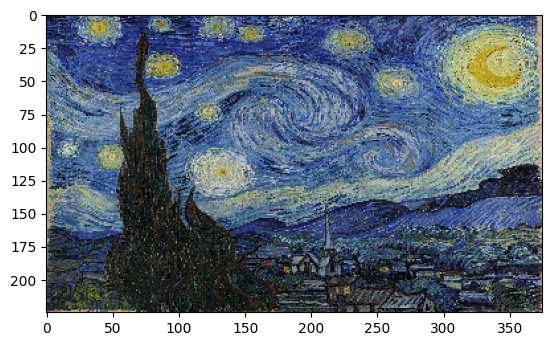

In [ ]:
plt.imshow(image);

In [ ]:
# 우리가 받아온 이미지의 타입은 plt라이브러리에서 제공하는 이미지 타입이다.
type(image)

PIL.Image.Image

In [ ]:
image.size

(375, 225)

In [ ]:
image.mode, len(image.mode)

('RGB', 3)

In [ ]:
# 모든 픽셀의 RGB 값을 볼수 있다.(Red, Green, Blue)
list(image.getdata())

[(6, 10, 11),
 (30, 33, 66),
 (35, 46, 66),
 (39, 46, 65),
 (46, 49, 68),
 (23, 27, 39),
 (13, 15, 38),
 (57, 61, 86),
 (85, 88, 97),
 (147, 147, 139),
 (138, 139, 123),
 (112, 116, 117),
 (18, 21, 52),
 (23, 28, 60),
 (85, 96, 116),
 (83, 92, 121),
 (148, 152, 155),
 (29, 32, 63),
 (57, 63, 99),
 (12, 20, 39),
 (34, 39, 69),
 (23, 30, 56),
 (4, 12, 48),
 (25, 32, 74),
 (48, 50, 98),
 (134, 133, 173),
 (127, 132, 152),
 (126, 133, 161),
 (138, 151, 168),
 (64, 76, 126),
 (67, 83, 119),
 (61, 75, 112),
 (73, 90, 134),
 (86, 118, 143),
 (55, 81, 80),
 (136, 155, 135),
 (51, 65, 74),
 (152, 169, 195),
 (156, 176, 211),
 (56, 79, 129),
 (94, 116, 165),
 (70, 94, 120),
 (160, 173, 189),
 (142, 156, 185),
 (92, 118, 135),
 (50, 74, 118),
 (107, 132, 162),
 (101, 122, 153),
 (27, 36, 67),
 (34, 44, 79),
 (97, 114, 140),
 (21, 41, 66),
 (51, 60, 101),
 (50, 56, 104),
 (34, 39, 68),
 (22, 24, 45),
 (3, 3, 29),
 (4, 7, 22),
 (28, 37, 34),
 (19, 27, 29),
 (19, 25, 41),
 (43, 49, 75),
 (93, 104, 1

In [ ]:
# 하지만 신경망에 이미지를 입렵할려면 numpy형식으로 변환해줘야한다.
# tf에선 해당 함수를 제공한다.
image = tf.keras.preprocessing.image.img_to_array(image)

In [ ]:
type(image)

numpy.ndarray

In [ ]:
image.shape # 우리가알던(높이, 너비, 채널수) 형식으로 반환된다.

(225, 375, 3)

In [ ]:
image.min(), image.max()

(0.0, 255.0)

In [ ]:
# 연산을 줄이고 효과를 늘리기위해 데이터를 정규화해야한다.
# 딥 드림 알고리즘에선 0~ 1로 정규화하지 않고 -1 ~ 1 로변환 한다.
# 앞에서 사용하였던 tf.keras.applications.InceptionV3과 비슷하지만 preprocess_input함수는 _v3만 사용가능하다(자세한건 나도모)
image = tf.keras.applications.inception_v3.preprocess_input(image)

### Getting the activations
- 생성한 모델의 은닉층 output에서 activations 값 가져오기

In [ ]:
image.shape

(225, 375, 3)

In [ ]:
# 신경망에 이미지 인풋을 넣을려면 배치형식으로 변환해줘야한다.
# 배치 형식으로 변화하는 함수는 여러개이다. tf,numpy에선 expand_dim()함수를 사용할 수 있고 reshape도 가능하다.
image_batch = tf.expand_dims(image, axis=0)
image_batch.shape

TensorShape([1, 225, 375, 3])

In [ ]:
# 모든 픽셀을 딥드림 모델에 통과
# 이전에 생성한 모델의 output이 은닉층의 활성화 값이다.
activations = deep_dream_model.predict(image_batch)

1/1 [==============================] - 1s 1s/step


In [ ]:
# 2개의 아웃풋 층이 있으니 길이는 2이다. -> 리스트형태로 반환 -> 안에는 numpy형태로 뉴런들이 있다.
len(activations), activations[0].shape, activations[1].shape

(2, (1, 12, 21, 768), (1, 12, 21, 768))

In [ ]:
# 해당 차원의 형태는 (1, 12, 21, 768)이다.
# 1은 해당 이미지이고 12, 21은 해당 이미지의 높이와 너비임을 알려준다. 왜 이미지의 높이와 너비가(12,21)로 줄었냐면 폴링층을 거치면서 이미지의 크기가 줄었기 때문이다.
# 768은 채널이라고 생각하면된다(커널의 수)
activations[1]

array([[[[0.        , 0.        , 1.495175  , ..., 0.        ,
          0.        , 0.        ],
         [2.1904209 , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [1.22522   , 0.        , 0.39387962, ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.2709857 , ..., 1.2395117 ,
          0.        , 0.        ],
         [0.        , 0.15095812, 0.64265513, ..., 0.9167088 ,
          0.        , 0.        ],
         [0.        , 0.        , 1.6167855 , ..., 0.5969094 ,
          0.        , 0.        ]],

        [[0.        , 0.        , 0.        , ..., 0.05806589,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.67039937, 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 1.2452445 ,
          0.        , 0.0

# Calculating the loss
- 손실 함수 계산(사실은 이전의 사용했던 손실함수를 사용하진 않는다.)
  - 딥드림에서의 손실 함수는 일반적인 학습에서 사용되는 것과는 다르다. 보통의 딥러닝 작업에서는 실제 값과 예측 값 간의 차이를 최소화하기 위한 손실 함수를 정의하고, 이 손실을 기반으로 모델을 학습시키지만 딥드림은 레이블이 없는 이미지로 작업하며, 따라서 예측 값이나 실제 값이 없다.

  - 따라서 딥드림에선 직접적으로 손실값을 구하는 것 보다 현재 층의 활성화 값을 최대로 하는 방향으로 학습을 진행한다. 이 뜻은 해당 층이 정의하고 있는 특징을 극대화 하여 이미지에 나타내주는것을 말한다.

In [ ]:
def calculate_loss(image, network):
  # 원본 이미지를 배치 사이즈로 변환
  image_batch = tf.expand_dims(image, axis = 0)
  # 은닉층의 활성화 값을 가져온다.
  # network.predict(image_batch)와 network(image_batch)는 동일한 결과를 반환하는데, 호출 방식에 차이가 있다.
  # predict는 Keras에서 제공하는 Model객체의 predict()를 호출한다면 network()는 network객체를 이미지와 함께 호출하여 실행시키는것이다.
  # 이후 사용할 @tf.function에선 predict을 사용할수 없기때문에 network함수를 사용한다.
  # keras에서 제공하는 고수준 API라 tf 그래프로 변환되기 힘들어 그냥 고수준 API들을 막아놨다
  activations = network(image_batch)
  # print(activations)

  losses = []
  for act in activations :
    # 우리가 구한 은닉층의 activation 값들을 전부 더한후 요소의 값만큼 나누어 평균을구한다.
    # 평균은 각각의 차원안에서 구한후 다음 차원으로 또 구하는식으로 구해진다.
    # 4차원에서 1차원 값으로 반환이 되니 reduce라는 키워드가 붙었다.
    loss = tf.math.reduce_mean(act)
    losses.append(loss)
  # 각각의 평균값을 그냥 더한다.
  return tf.reduce_sum(losses)

In [ ]:
loss = calculate_loss(image, deep_dream_model)
print(loss)

tf.Tensor(0.61807656, shape=(), dtype=float32)


# Gradient ascent (경사 상승법)
- 구해진 activation 평균값을 이용하여 그 값이 최대가 되도록 경사 상승법을 활용하여 이미지를 수정한다.
  - 그래디언트를 구하기위해 자동미분을 위해 각 층의 미분값을 기록해야될 필요가 있다.
  - tf.GradientTape() 객체는 자동으로 미분을 기록하지 않는 탠서를 이놈이 추적하여 자신이 대신 기록해준다.
    - 위에서 작성한 calculate_loss()함수는 학습 모드가 아니라 각각의 미분값을 기록해두지 않는다. 따라서 GradientTape()객체를 활용하여 따로 기록하고 그래디언트를 수동으로 구해야한다.
  - watch(감지할 텐서) - 원래는 텐서나 텐서를 포함한 리스트만 가능하지만 tf는 numpy도 자동으로 텐서로 변환해준다.


In [ ]:
print(image)

[[[-0.9529412  -0.92156863 -0.9137255 ]
  [-0.7647059  -0.7411765  -0.4823529 ]
  [-0.7254902  -0.6392157  -0.4823529 ]
  ...
  [ 0.36470592  0.20784318  0.0196079 ]
  [ 0.24705887  0.13725495 -0.1372549 ]
  [ 0.49803925  0.38823533  0.082353  ]]

 [[-0.8980392  -0.8901961  -0.73333335]
  [-0.7647059  -0.7490196  -0.42745095]
  [-0.8039216  -0.7490196  -0.52156866]
  ...
  [ 0.30980396  0.16078436 -0.09803921]
  [ 0.49803925  0.3803922   0.07450986]
  [ 0.37254906  0.24705887 -0.01176471]]

 [[-0.8352941  -0.827451   -0.5921569 ]
  [-0.88235295 -0.8666667  -0.56078434]
  [-0.827451   -0.79607844 -0.58431375]
  ...
  [ 0.58431375  0.41960788  0.17647064]
  [ 0.60784316  0.45098042  0.16078436]
  [ 0.5529412   0.41176474  0.12941182]]

 ...

 [[-0.6862745  -0.7411765  -0.96862745]
  [-0.73333335 -0.7176471  -0.827451  ]
  [-0.79607844 -0.7490196  -0.78039217]
  ...
  [-0.654902   -0.60784316 -0.40392154]
  [-0.45098037 -0.5137255  -0.12941176]
  [-0.3490196  -0.5294118  -0.5764706 ]]

 [

In [ ]:
# @(데코레이터)란?
# 바로 다음에 오는 함수나 메서드에 적용되어 해당 함수나 메서드의 기능을 확장하거나 변경하는 역할
@tf.function
def deep_dream(network, image, learning_rate):
  # with절이란?
  # 자원을 획득하고 ,사용하고, 반납하는 작업을할때 with절 이 시작되면 획득하고 벗어나면 자동으로 반납할수 있도록하는 구문이다.
  with tf.GradientTape() as tape:
    tape.watch(image)
    loss = calculate_loss(image, network)
    print(loss)

  # tf.GradientTape()을 사용하여 이미지에 대한 손실의 그래디언트를 계산
  gradients = tape.gradient(loss, image)
  #print(type(gradients))
  #print(gradients)
  # 그래디언트를 정규화한다(그래디언트들의 표준편차로 각각의 그래디언트를 정규화)
  gradients /= tf.math.reduce_std(gradients)
  # 이미지의 픽셀을 변경한다 (원본 + 그래디언트 * 학습률)
  image = image + gradients * learning_rate
  # 이미지를 (-1,1)범위로 클리핑
  # 클리핑: 각각의 픽셀이 -1, 1을 변경에 의해 넘긴다면 그냥 -1 또는 1로 바꾸어 이상치를 방지한다.
  image = tf.clip_by_value(image, -1, 1)
  return loss, image

In [ ]:
# deep_dream(deep_dream_model,image, 0.001)

In [ ]:
def inverse_transform(image):
  image = 255 * (image + 1.0) / 2.0
  return tf.cast(image, tf.uint8)

In [ ]:
def run_deep_dream(network, image, epochs, learning_rate):
  for epoch in range(epochs):
    loss, image = deep_dream(network, image, learning_rate)

    if epoch % 200 == 0:
      plt.figure(figsize=(12,12))
      plt.imshow(inverse_transform(image))
      plt.show()
      print('Epoch {}, loss {}'.format(epoch, loss))

### Generating images
- 딥드림을 통한 이미지 생성

In [ ]:
image.shape, type(image)

((225, 375, 3), numpy.ndarray)

In [ ]:
run_deep_dream(network=deep_dream_model, image=image, epochs = 8000, learning_rate=0.0001)

Output hidden; open in https://colab.research.google.com to view.

## AdditionalTask

In [ ]:
image = tf.keras.preprocessing.image.load_img('/content/drive/MyDrive/Colab Notebooks/Project/Computer Vision/src/Images/sky.jpeg',
                                              target_size = (225, 375))

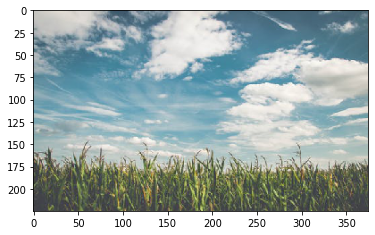

In [ ]:
plt.imshow(image);

In [ ]:
image = tf.keras.preprocessing.image.img_to_array(image)
image = tf.keras.applications.inception_v3.preprocess_input(image)

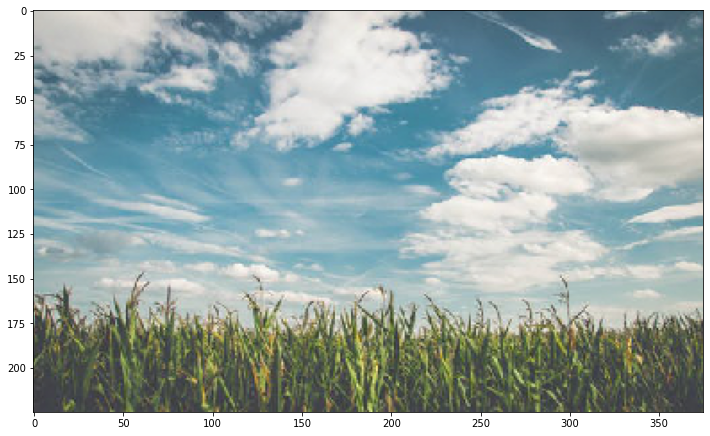

Epoch 0, loss 0.6144235134124756


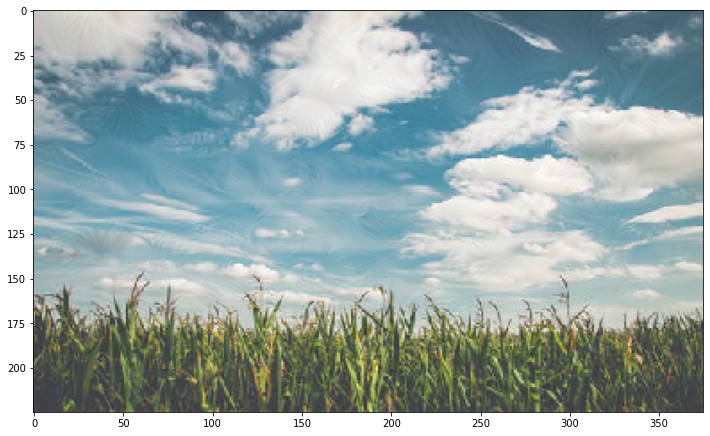

Epoch 200, loss 0.9559670686721802


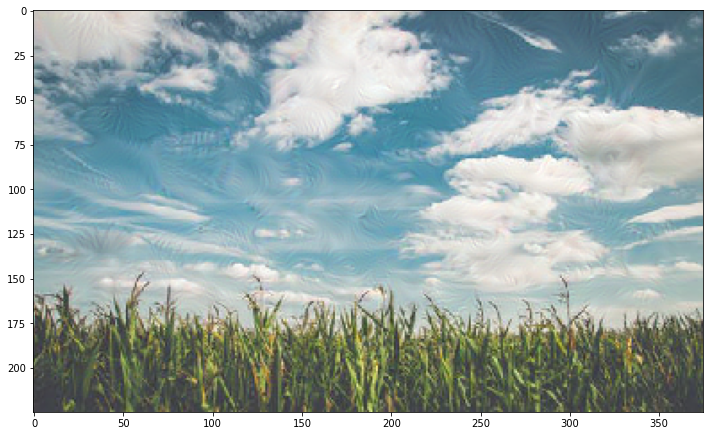

Epoch 400, loss 1.1461961269378662


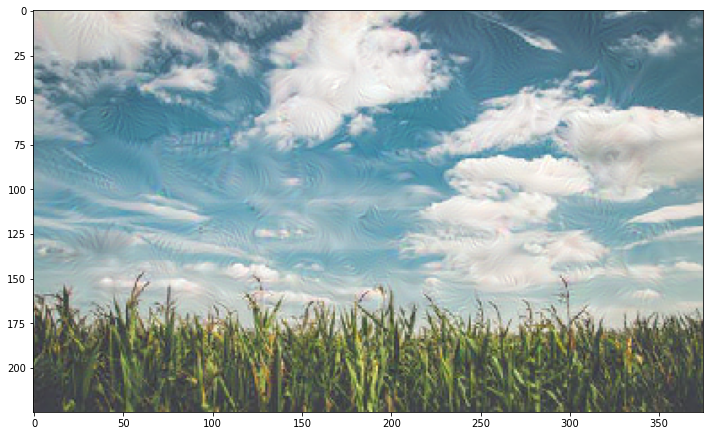

Epoch 600, loss 1.2786353826522827


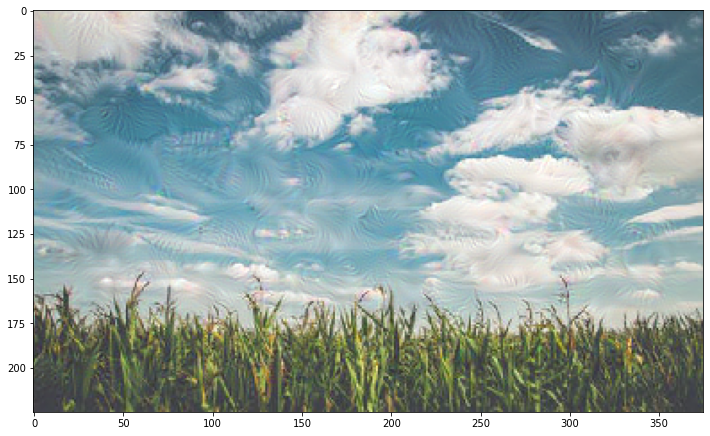

Epoch 800, loss 1.378812313079834


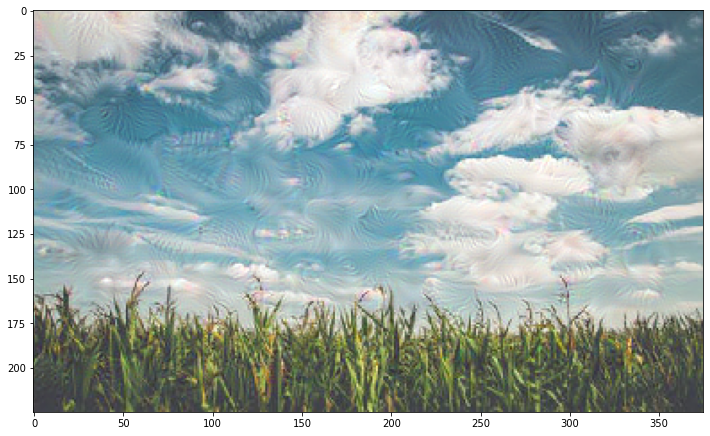

Epoch 1000, loss 1.4574533700942993


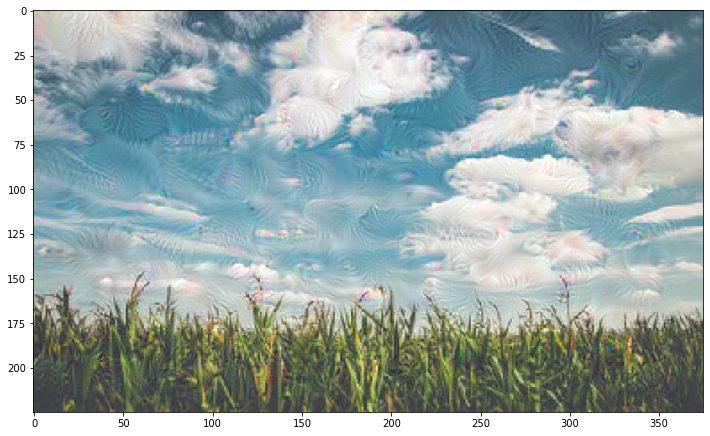

Epoch 1200, loss 1.523162841796875


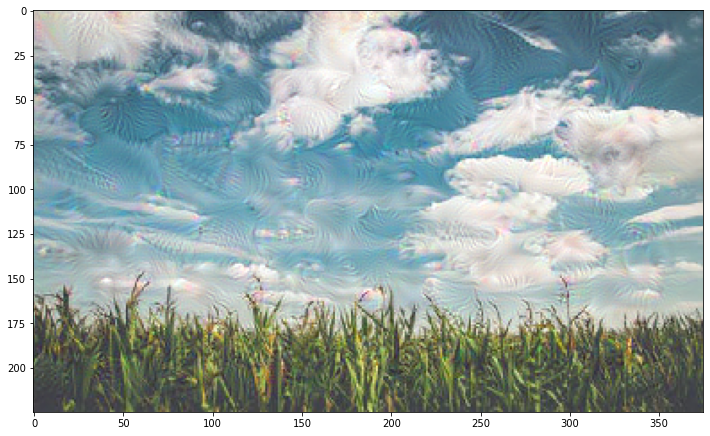

Epoch 1400, loss 1.57943856716156


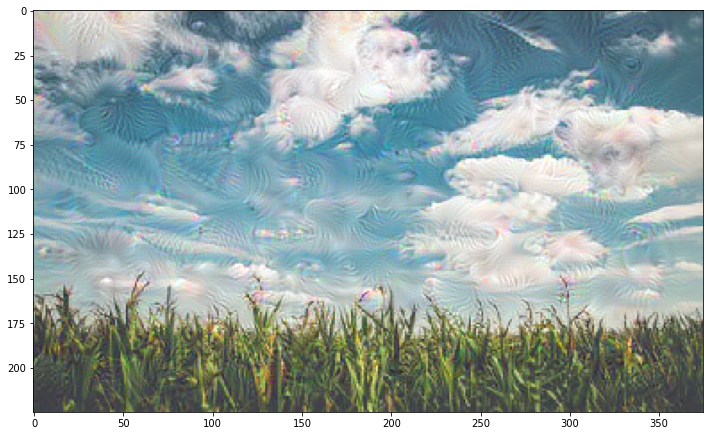

Epoch 1600, loss 1.6276543140411377


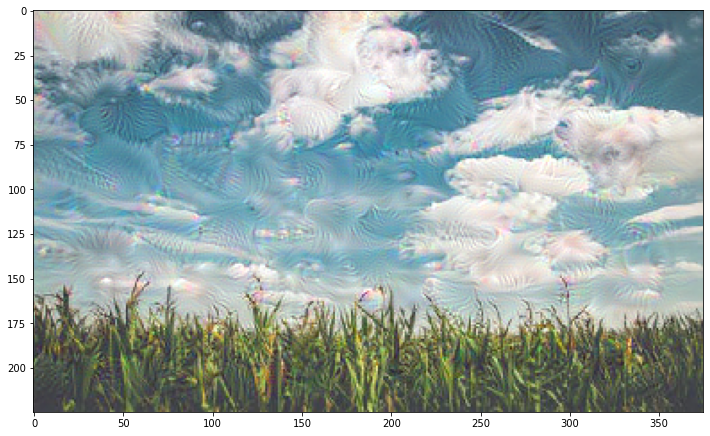

Epoch 1800, loss 1.670001745223999


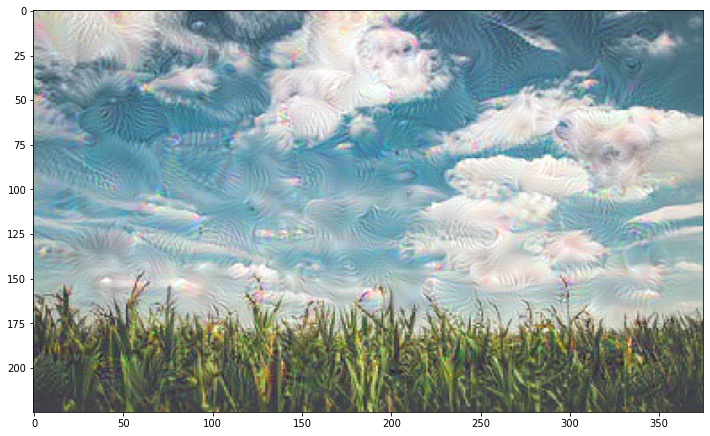

Epoch 2000, loss 1.7075235843658447


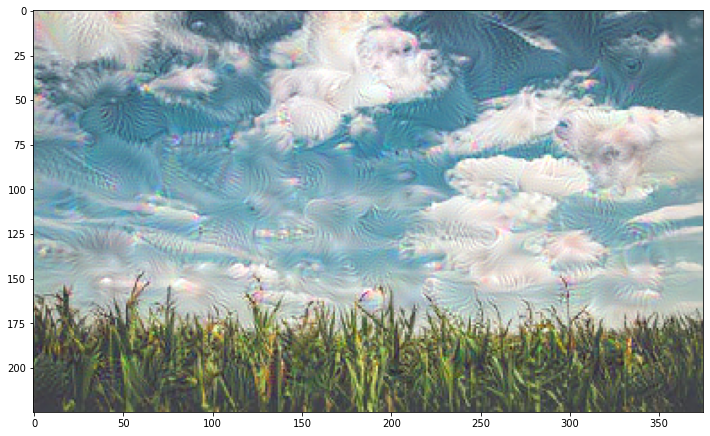

Epoch 2200, loss 1.7416073083877563


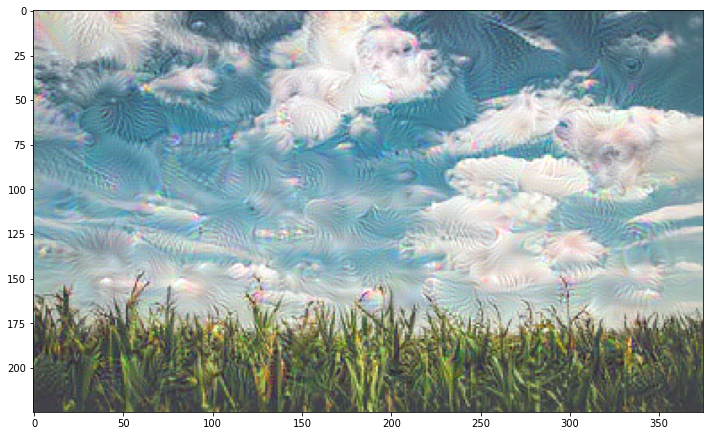

Epoch 2400, loss 1.773117184638977


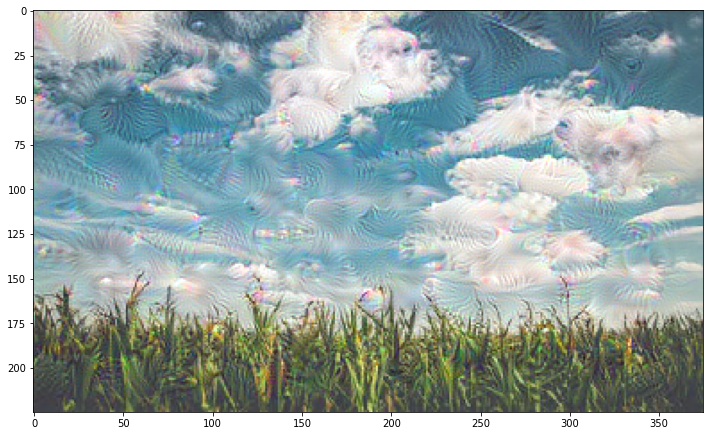

Epoch 2600, loss 1.8020826578140259


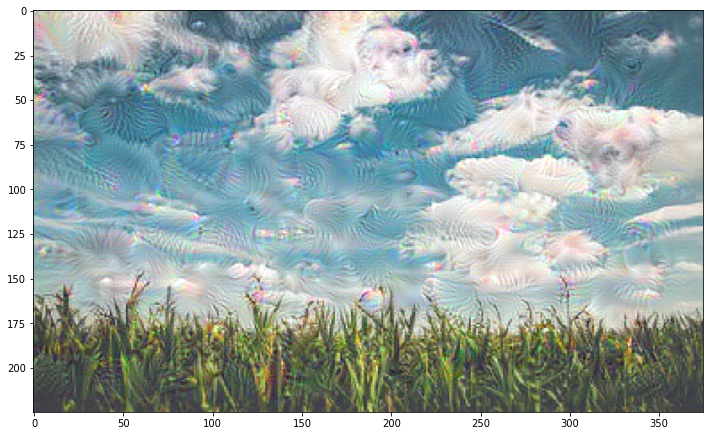

Epoch 2800, loss 1.8290600776672363


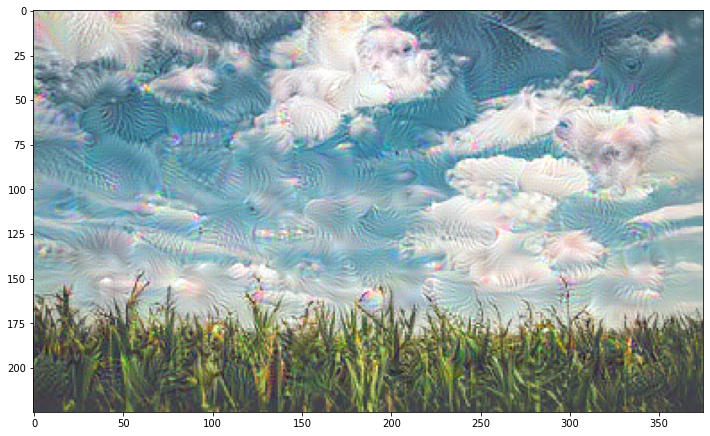

Epoch 3000, loss 1.854574203491211


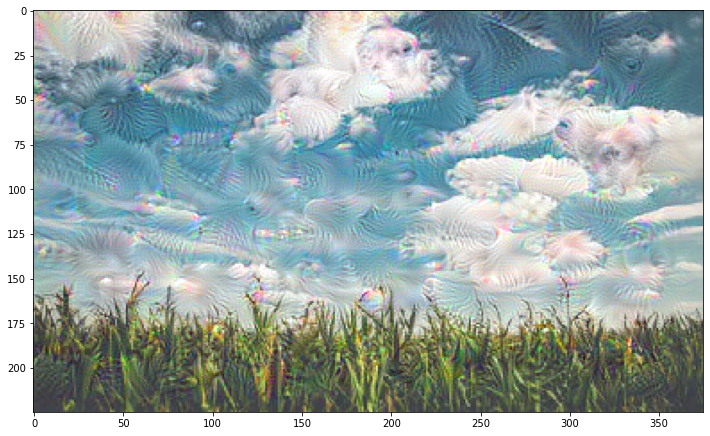

Epoch 3200, loss 1.878263235092163


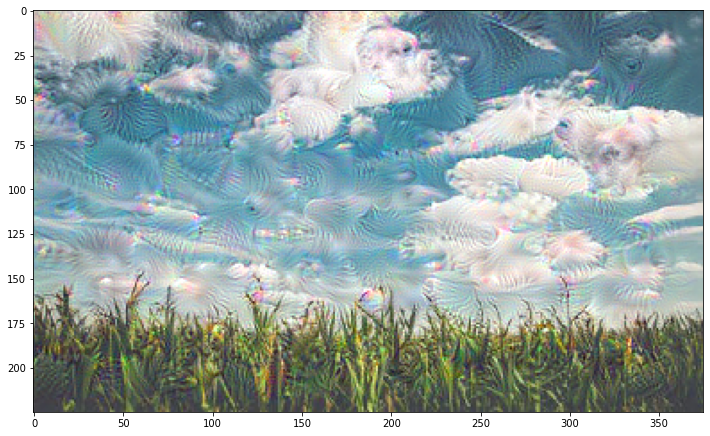

Epoch 3400, loss 1.900646686553955


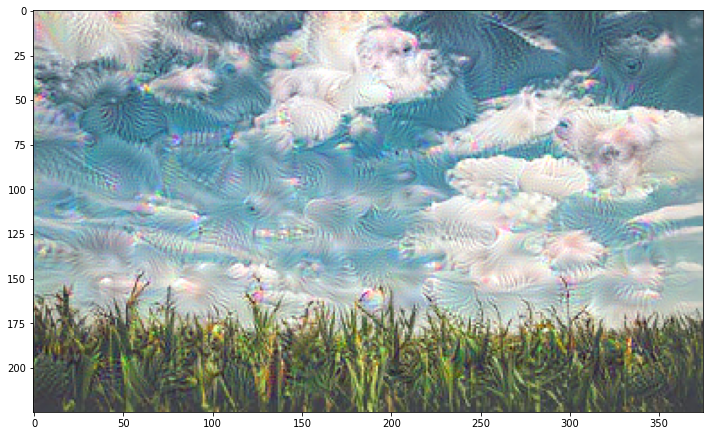

Epoch 3600, loss 1.9221255779266357


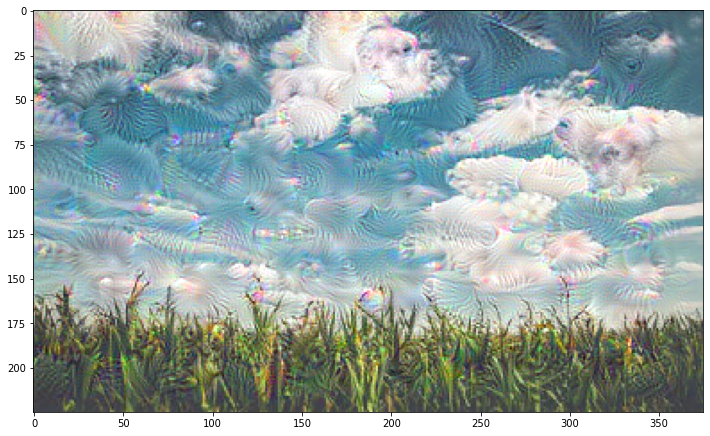

Epoch 3800, loss 1.942427396774292


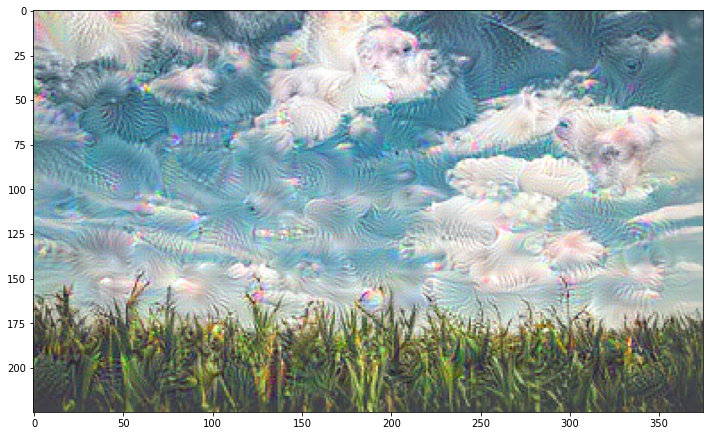

Epoch 4000, loss 1.9618232250213623


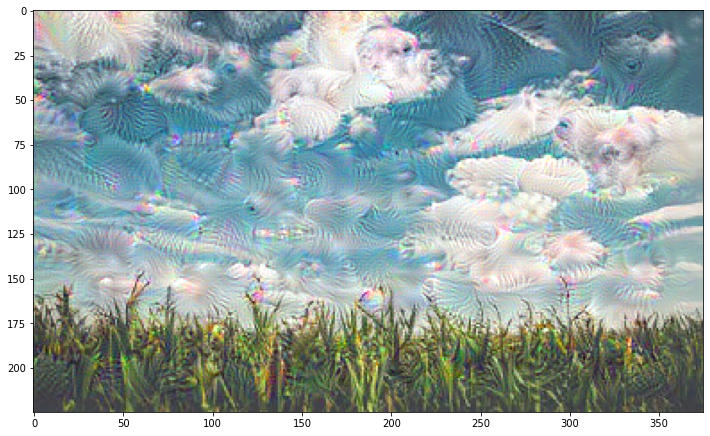

Epoch 4200, loss 1.9805891513824463


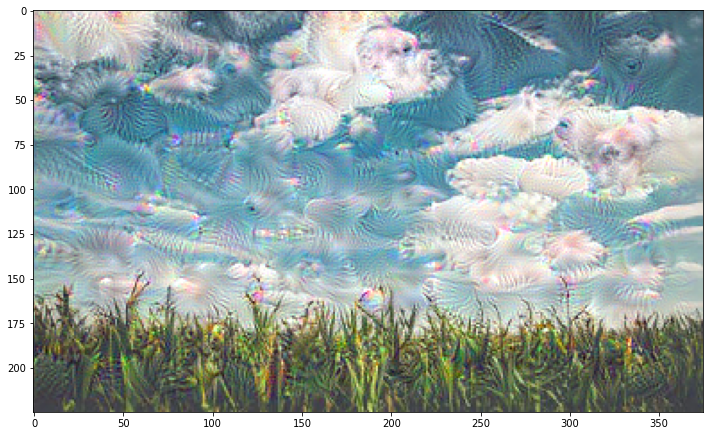

Epoch 4400, loss 1.998737096786499


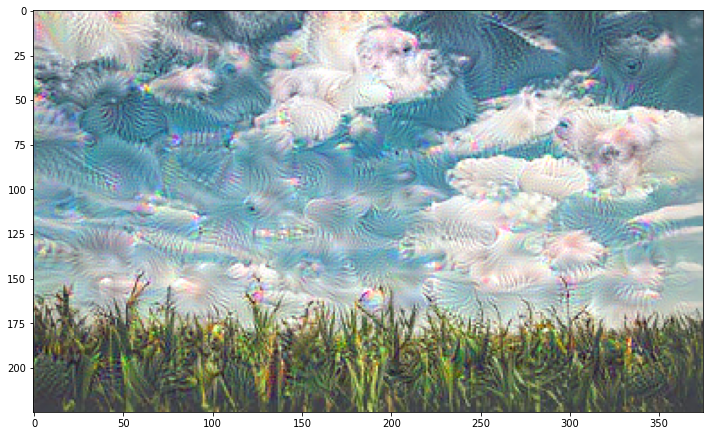

Epoch 4600, loss 2.016355276107788


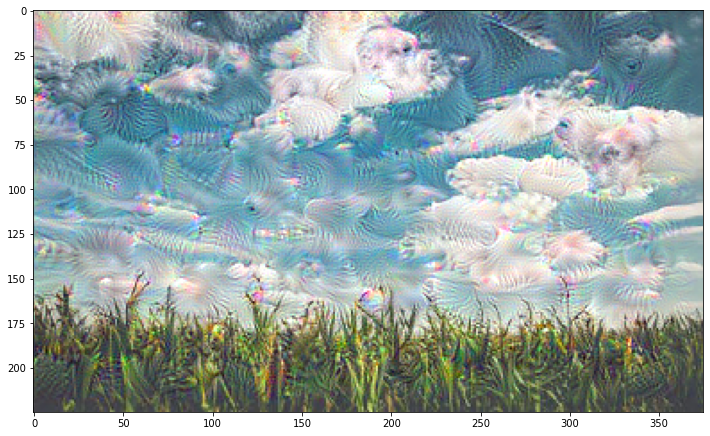

Epoch 4800, loss 2.033545970916748


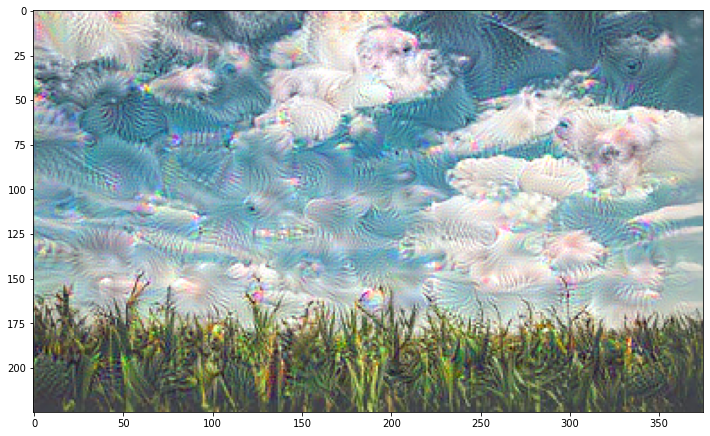

Epoch 5000, loss 2.049970865249634


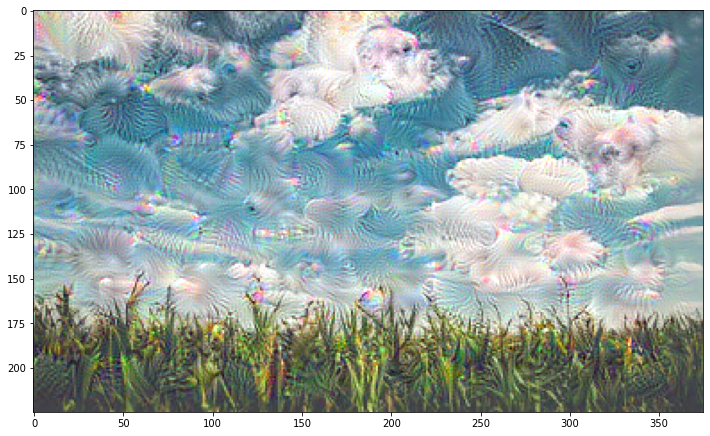

Epoch 5200, loss 2.065629243850708


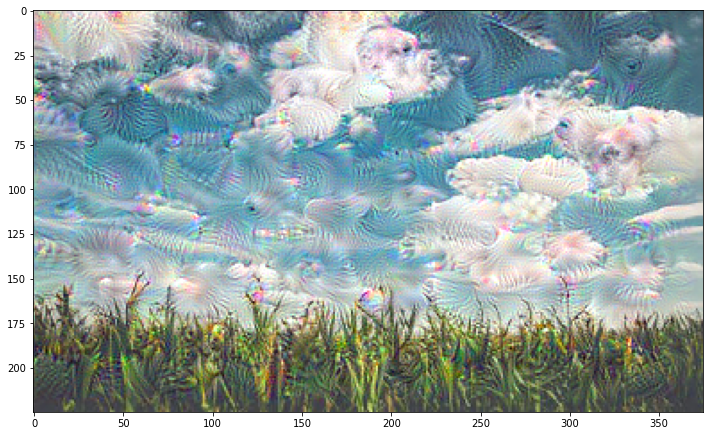

Epoch 5400, loss 2.0809593200683594


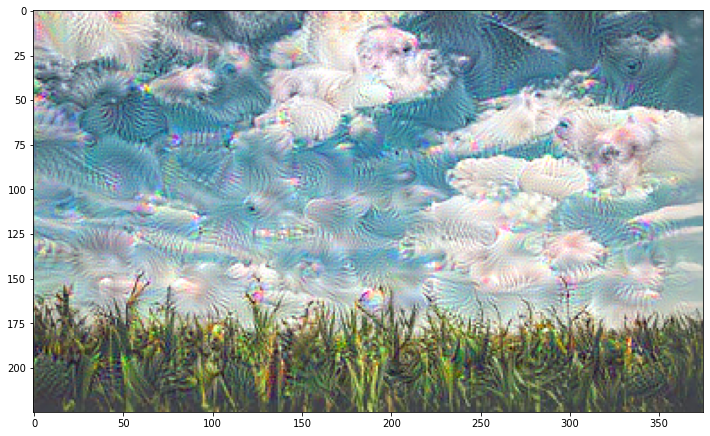

Epoch 5600, loss 2.0958969593048096


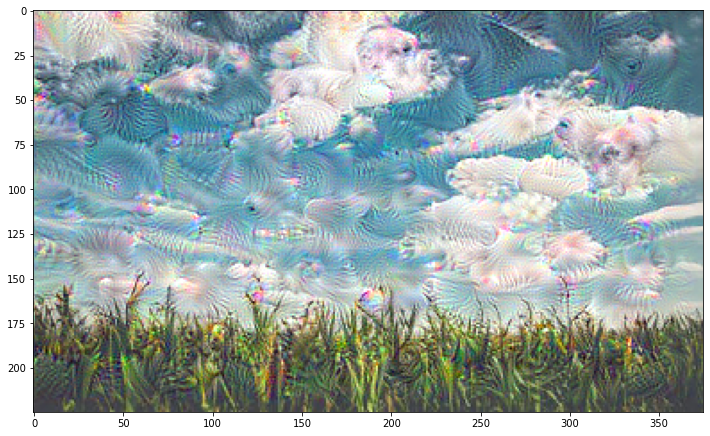

Epoch 5800, loss 2.1103641986846924


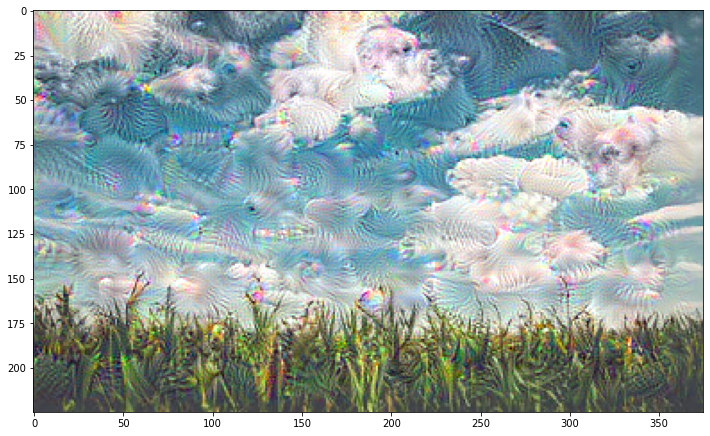

Epoch 6000, loss 2.1243503093719482


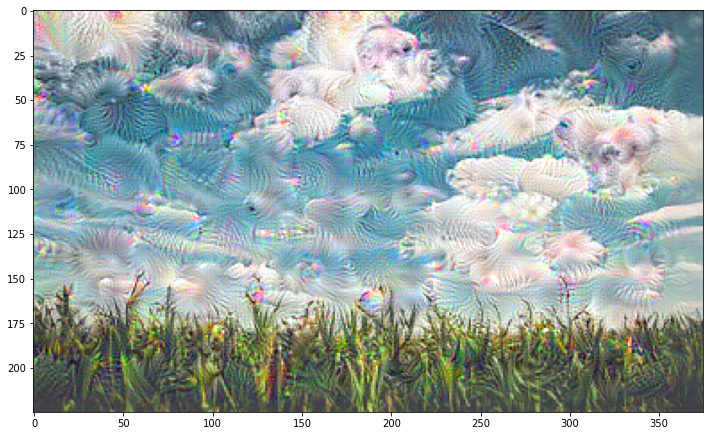

Epoch 6200, loss 2.1380248069763184


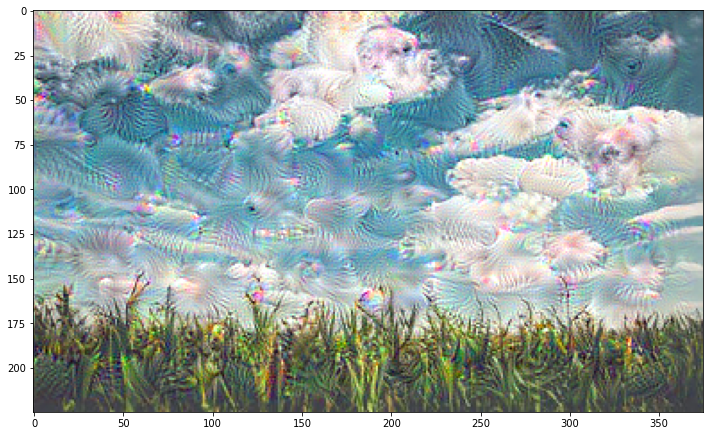

Epoch 6400, loss 2.1510934829711914


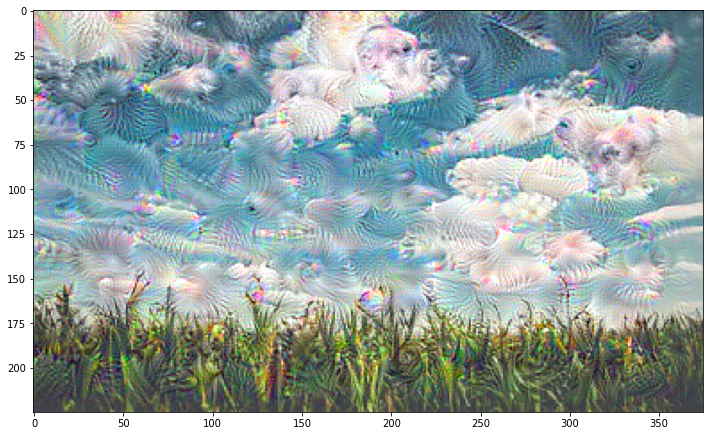

Epoch 6600, loss 2.1638145446777344


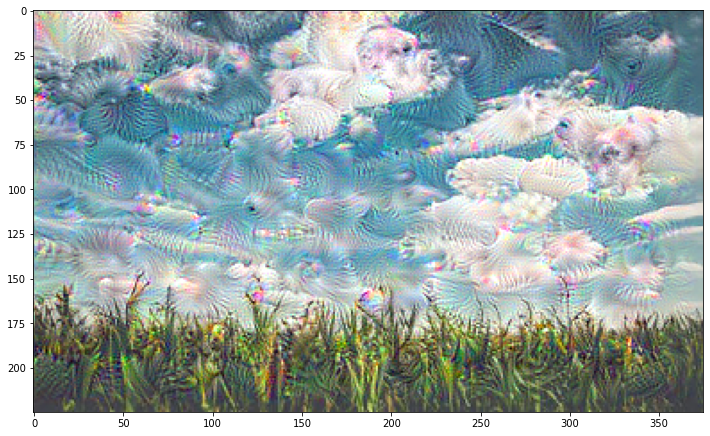

Epoch 6800, loss 2.1762640476226807


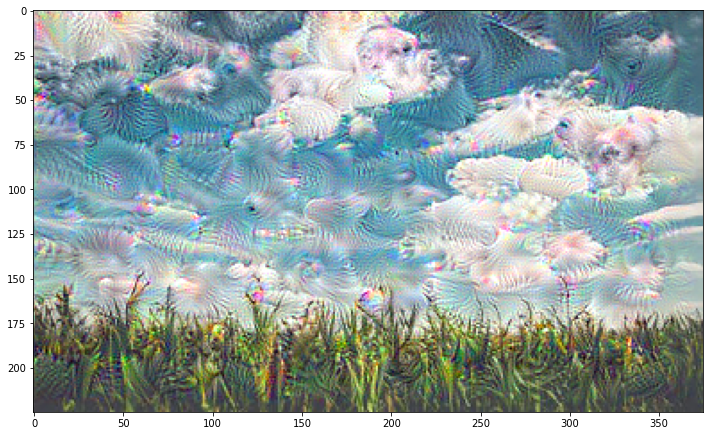

Epoch 7000, loss 2.188399076461792


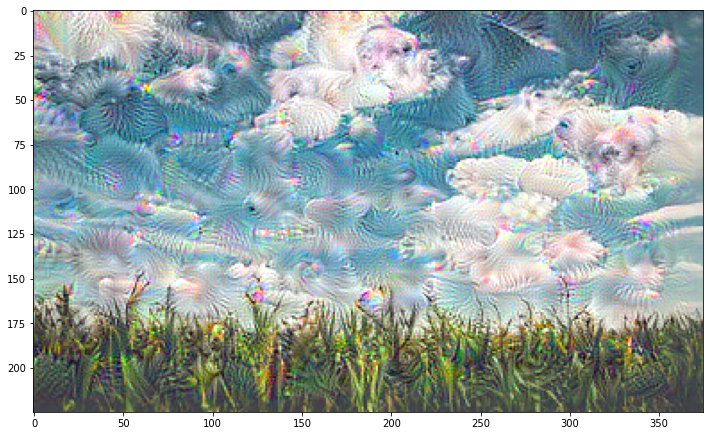

Epoch 7200, loss 2.200153350830078


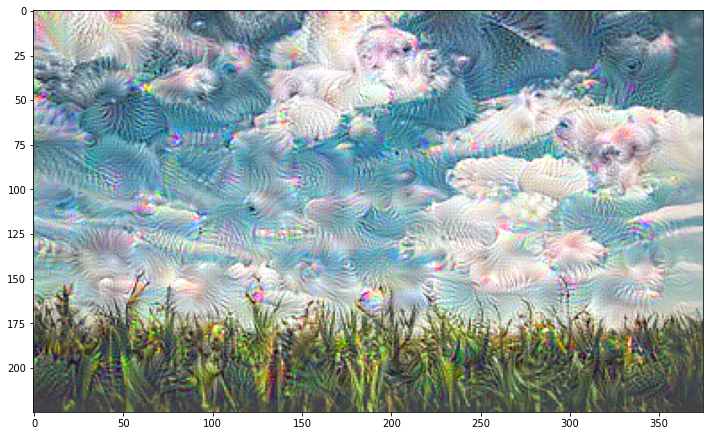

Epoch 7400, loss 2.2116613388061523


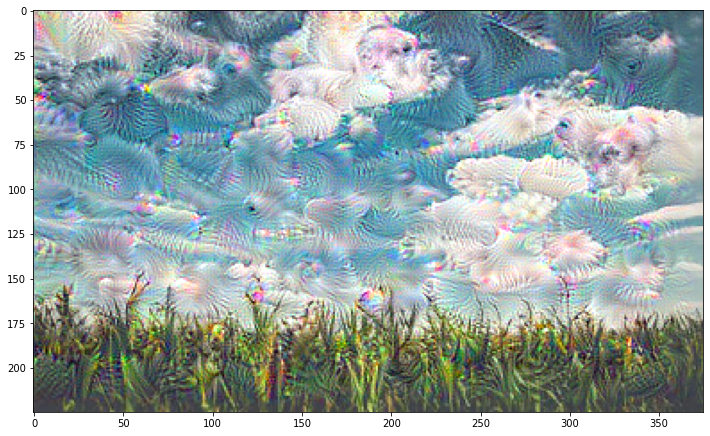

Epoch 7600, loss 2.2229299545288086


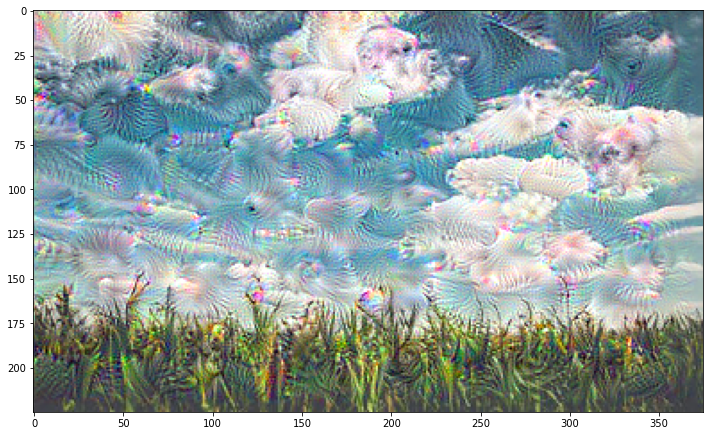

Epoch 7800, loss 2.234143018722534


In [ ]:
run_deep_dream(network = deep_dream_model, image = image, epochs = 8000, learning_rate = 0.0001)